## V0


In [ ]:
!pip install roboflow
!pip install ultralytics
!pip install yolov8

  Using cached ultralytics-8.1.47-py3-none-any.whl (750 kB)
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.19.3-py3-none-manylinux1_x86_64.whl (166.0 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (99 

In [ ]:
# Importar as bibliotecas necessárias
from roboflow import Roboflow

def import_dataset():
    # Configurar a chave da API do Roboflow
    rf = Roboflow(api_key="zW0D9OODuFlxgjHFbdD8")

    # Definir o projeto e versão do Roboflow
    project = rf.workspace("workspace-mji8r").project("landslide2")
    version = project.version(1)
    dataset = version.download("yolov8")

    return dataset.location

if __name__ == "__main__":
    dataset_location = import_dataset()


loading Roboflow workspace...
loading Roboflow project...
Dependency ultralytics==8.0.196 is required but found version=8.1.47, to fix: `pip install ultralytics==8.0.196`



Extracting Dataset Version Zip to landslide2-1 in yolov8:: 100%|██████████| 1998/1998 [00:00<00:00, 3443.63it/s]


In [ ]:

# Importar as bibliotecas necessárias
from ultralytics import YOLO

def training_and_validation(dataset_location):
    # Treinar o modelo YOLOv8
    !yolo task=segment mode=train model=yolov8n-seg.yaml data={dataset_location}/data.yaml epochs=20 imgsz=640

    # Validar o modelo YOLOv8
    !yolo task=segment mode=val model=/content/runs/segment/train/weights/best.pt data={dataset_location}/data.yaml

if __name__ == "__main__":


    # Chamar a função de treinamento e validação
    training_and_validation(dataset_location)


Ultralytics YOLOv8.1.47 🚀 Python-3.10.12 torch-2.2.1+cu121 CPU (Intel Xeon 2.20GHz)
engine/trainer: task=segment, mode=train, model=yolov8n-seg.yaml, data=/content/landslide2-1/data.yaml, epochs=20, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=Tr

Ultralytics YOLOv8.1.47 🚀 Python-3.10.12 torch-2.2.1+cu121 CPU (Intel Xeon 2.20GHz)
YOLOv8n-seg summary (fused): 195 layers, 3258259 parameters, 0 gradients, 12.0 GFLOPs

image 1/99 /content/landslide2-1/test/images/112_jpg.rf.d4401cfbaa31f3cc853ee76821c67693.jpg: 640x640 5 Landslidess, 432.0ms
image 2/99 /content/landslide2-1/test/images/117_jpg.rf.4a24ffc244b099356e8e10035a29a978.jpg: 640x640 1 Landslides, 327.2ms
image 3/99 /content/landslide2-1/test/images/119_jpg.rf.e1fdc13c9b85c8e8febd23ecb8f2764d.jpg: 640x640 1 Landslides, 331.4ms
image 4/99 /content/landslide2-1/test/images/120_jpg.rf.2f47b26db5164d2bad12911ef5b9c5cc.jpg: 640x640 1 Landslides, 335.6ms
image 5/99 /content/landslide2-1/test/images/122_jpg.rf.3b58f6a8caa39bb82a65134fef95cf68.jpg: 640x640 1 Landslides, 308.2ms
image 6/99 /content/landslide2-1/test/images/127_jpg.rf.0327425cc484f6829e1c6bb6a6c11a54.jpg: 640x640 2 Landslidess, 297.6ms
image 7/99 /content/landslide2-1/test/images/128_jpg.rf.4ecfda65c9b3602db9d5b96ba15

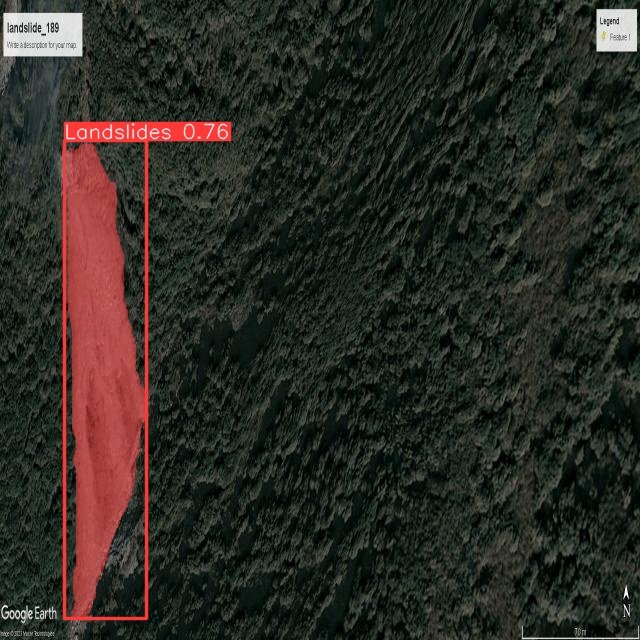

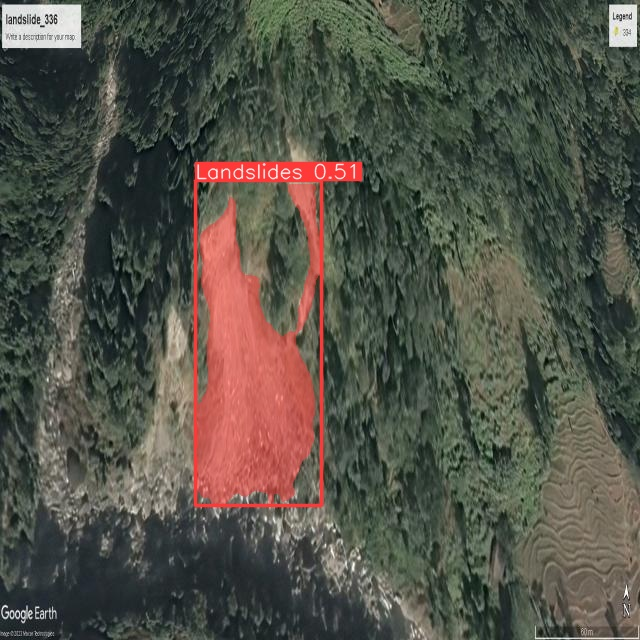

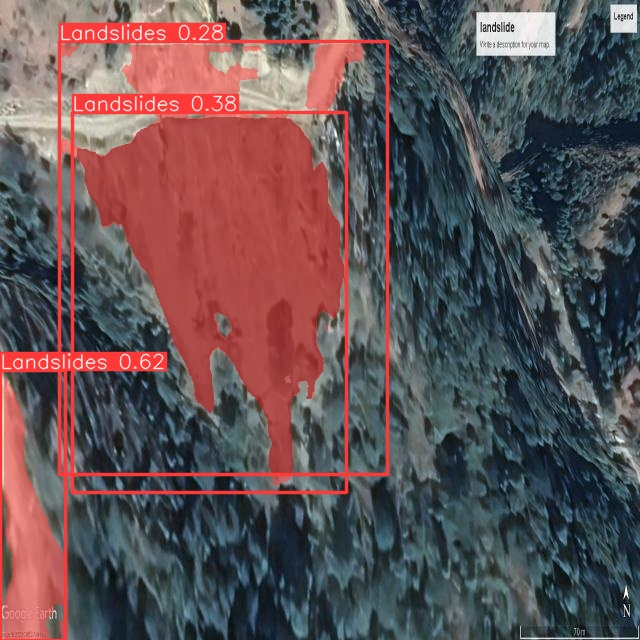

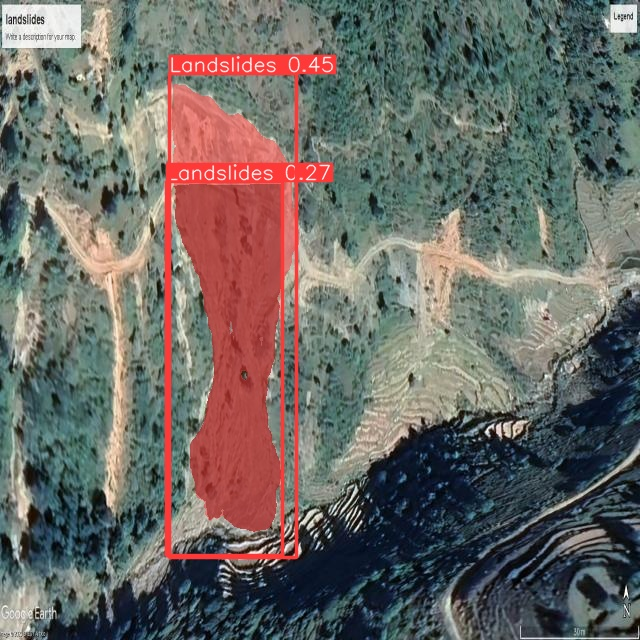

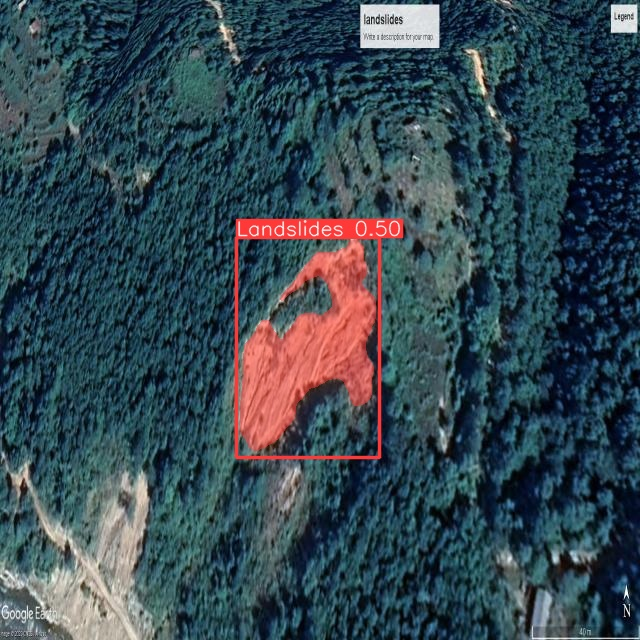

...

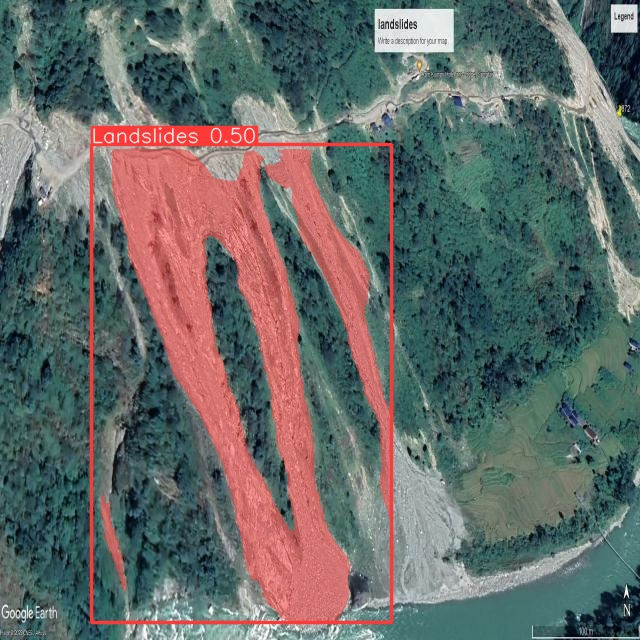

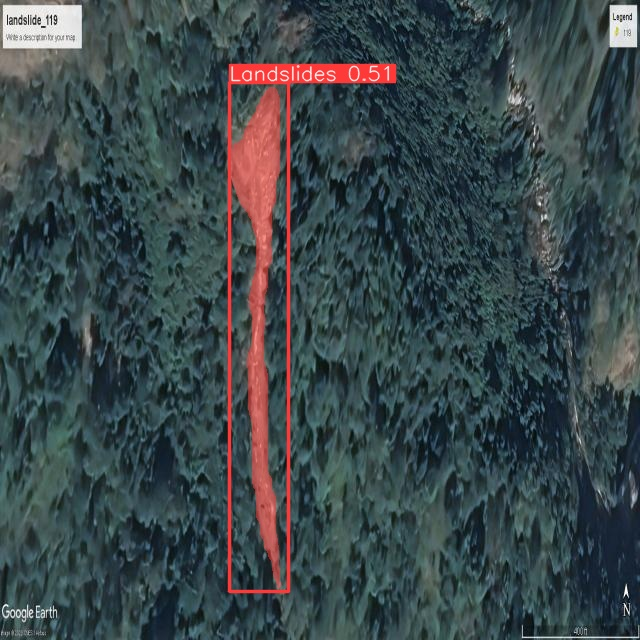

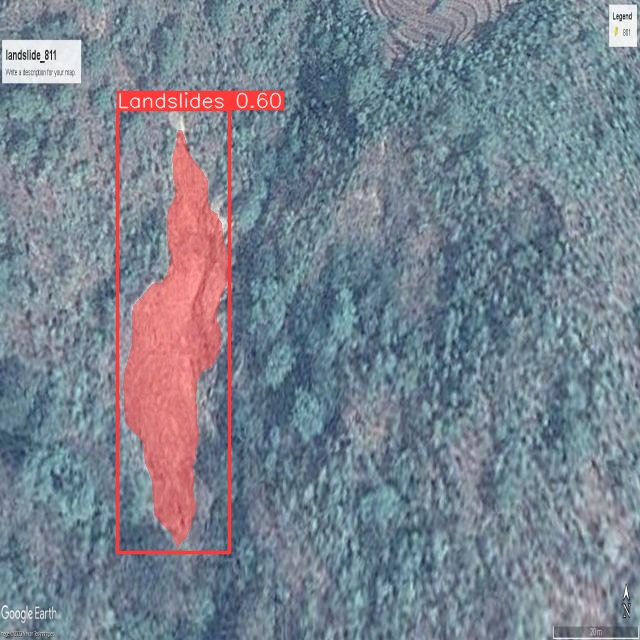

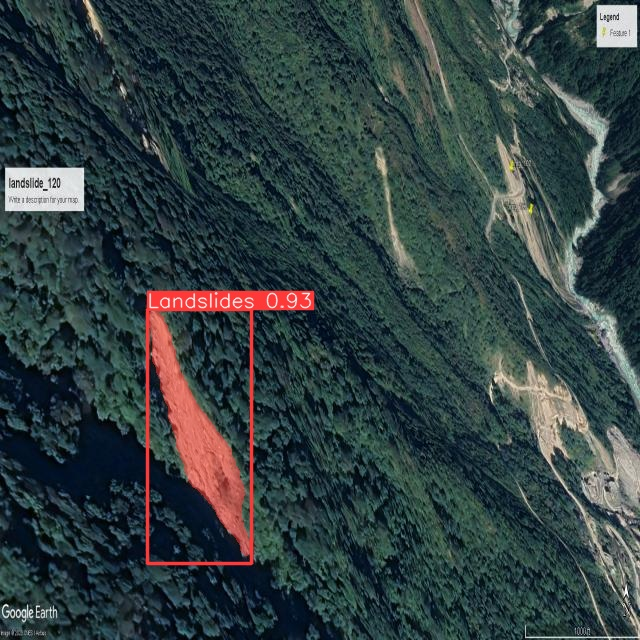

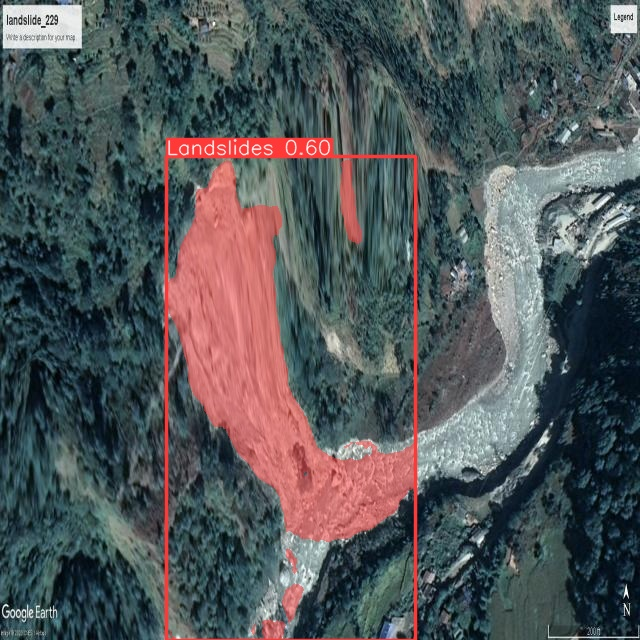

In [ ]:
# Importar as bibliotecas necessárias
import glob
from IPython.display import Image, display
from ultralytics import YOLO

# Função para predição
def prediction(caminho_imagens):
    # Carregar o modelo treinado

    !yolo task=segment mode=predict model=/content/runs/segment/train/weights/best.pt conf=0.25 source={dataset_location}/test/images save=True

    # Exibir as previsões
    for image_path in glob.glob("/content/runs/segment/predict/*.jpg"):
        display(Image(filename=image_path, height=600))
        print("\n")

if __name__ == "__main__":

    # Chamar a função de predição
    prediction("/content/landslide2-1/test/images")